In [1]:
from src.data.project4.dataloader import get_loaders
from src.utils import selective_search, plot_SS
import matplotlib.pyplot as plt
from tqdm import tqdm_notebook as tqdm


In [2]:
loaders = get_loaders('waste', batch_size=1, im_size = 256)

loading annotations into memory...
Done (t=0.09s)
creating index...
index created!
loading annotations into memory...
Done (t=0.18s)
creating index...
index created!
loading annotations into memory...
Done (t=0.05s)
creating index...
index created!


loading annotations into memory...
Done (t=0.08s)
creating index...
index created!
loading annotations into memory...
Done (t=0.05s)
creating index...
index created!
loading annotations into memory...
Done (t=0.05s)
creating index...
index created!


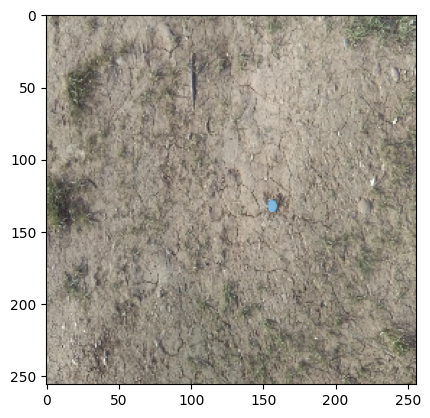

In [3]:
loaders = get_loaders('waste', batch_size=1, im_size = 256)
# Loading image
image = next(iter(loaders['train']))[0].squeeze()

plt.imshow(image.permute(1,2,0))

In [4]:
# Calculating bounding boxes
bboxes = selective_search(image)

/work3/s184984/repos/DL-COMVIS/venv/lib/python3.10/site-packages/skimage/feature/texture.py:353: UserWarning: Applying `local_binary_pattern` to floating-point images may give unexpected results when small numerical differences between adjacent pixels are present. It is recommended to use this function with images of integer dtype.
  warnings.warn(


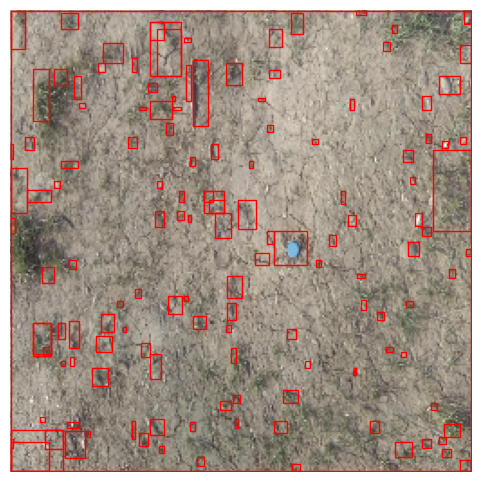

In [5]:
plot_SS(image, bboxes)

In [6]:
bboxes

{(0, 0, 8, 21),
 (0, 0, 255, 255),
 (0, 74, 1, 8),
 (0, 87, 9, 25),
 (0, 115, 2, 8),
 (0, 232, 29, 23),
 (0, 237, 1, 5),
 (0, 239, 21, 16),
 (8, 70, 5, 7),
 (9, 99, 13, 7),
 (12, 32, 9, 29),
 (12, 173, 10, 17),
 (12, 173, 10, 18),
 (16, 225, 3, 3),
 (17, 142, 7, 9),
 (18, 186, 3, 5),
 (19, 232, 10, 11),
 (24, 32, 7, 9),
 (24, 94, 3, 4),
 (26, 173, 4, 9),
 (28, 1, 9, 9),
 (28, 83, 9, 4),
 (28, 194, 2, 3),
 (30, 233, 11, 15),
 (31, 228, 7, 3),
 (32, 138, 4, 5),
 (32, 172, 6, 15),
 (33, 192, 2, 5),
 (35, 36, 4, 13),
 (38, 51, 3, 3),
 (42, 233, 2, 3),
 (45, 198, 9, 10),
 (47, 180, 9, 9),
 (48, 29, 4, 5),
 (50, 168, 7, 10),
 (51, 18, 11, 11),
 (59, 161, 3, 3),
 (62, 175, 2, 3),
 (65, 70, 5, 6),
 (67, 26, 3, 8),
 (67, 227, 2, 10),
 (69, 154, 3, 5),
 (71, 53, 4, 2),
 (71, 234, 5, 7),
 (72, 184, 5, 8),
 (76, 40, 5, 5),
 (77, 6, 8, 10),
 (77, 6, 17, 30),
 (77, 50, 12, 10),
 (77, 190, 6, 14),
 (77, 226, 8, 9),
 (80, 111, 5, 9),
 (81, 10, 13, 26),
 (81, 94, 3, 4),
 (82, 241, 3, 4),
 (86, 62, 4, 7

# Doing BBOXES on all images, saving as JSON

In [7]:
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, Dataset, Subset
import numpy as np
from PIL import Image, ExifTags
from pycocotools.coco import COCO
import json
import random

from albumentations.pytorch import ToTensorV2
import albumentations as A

from src.utils import set_seed
from src.utils import selective_search, plot_SS

In [9]:
im_size = 512

data_path='/dtu/datasets1/02514/data_wastedetection'

img_size = (im_size, im_size)
# Define transforms for training
train_transform = A.Compose([
    A.Resize(img_size[0], img_size[1]),
    ToTensorV2(),
], bbox_params=A.BboxParams(format='coco', label_fields=['category_ids']), is_check_shapes=False)

transform = train_transform

# Read annotations

anns_file_path = data_path + '/' + 'annotations.json'

coco = COCO(anns_file_path)

with open(anns_file_path, 'r') as f:
    dataset = json.loads(f.read())

# get image id and paths
image_paths = [(coco.getAnnIds(imgIds=img_data['id'], catIds=[], iscrowd=None), img_data['file_name']) for img_data in dataset['images']]

# Obtain Exif orientation tag code
for orientation in ExifTags.TAGS.keys():
    if ExifTags.TAGS[orientation] == 'Orientation':
        break
    
save_list = []

for idx in tqdm(range(len(image_paths))):

    # IMAGE
    # load ids
    anno_id, img_path = image_paths[idx]
    # Load and process image metadata
    image = Image.open(data_path + '/' + img_path)
    if image._getexif():
        exif = dict(image._getexif().items())
        # Rotate portrait and upside down images if necessary
        if orientation in exif:
            if exif[orientation] == 3:
                image = image.rotate(180,expand=True)
            if exif[orientation] == 6:
                image = image.rotate(270,expand=True)
            if exif[orientation] == 8:
                image = image.rotate(90,expand=True)
                
    image = np.array(image) / 255 
    image = image.astype(np.float32)
    # BBOX AND LABEL
    # Load mask ids
    category_ids, bboxes = zip(*[(item['category_id'], item['bbox']) for item in coco.loadAnns(anno_id)])
    
    # TRANSFORM
    try: 
        transformed = transform(image=image, bboxes = bboxes, category_ids = category_ids)
    except ValueError:
        print(f"Error in {img_path}")


    bboxes = selective_search(transformed['image'])
    save_list.append({img_path: bboxes})

loading annotations into memory...
Done (t=0.08s)
creating index...
index created!


/tmp/ipykernel_167423/3955064800.py:33: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for idx in tqdm(range(len(image_paths))):


  0%|          | 0/1500 [00:00<?, ?it/s]

/work3/s184984/repos/DL-COMVIS/venv/lib/python3.10/site-packages/skimage/feature/texture.py:353: UserWarning: Applying `local_binary_pattern` to floating-point images may give unexpected results when small numerical differences between adjacent pixels are present. It is recommended to use this function with images of integer dtype.
  warnings.warn(


Error in batch_10/000008.jpg
Error in batch_10/000011.jpg
Error in batch_11/000008.jpg
Error in batch_11/000077.jpg
Error in batch_13/000056.jpg
Error in batch_14/000048.jpg
Error in batch_15/000078.jpg


In [10]:
dct = {}
for list in save_list:
    for key, value in list.items():
        dct[key] = value

In [11]:
import pickle

with open('/work3/s184984/02514/project4/bboxes/bboxes.pkl', 'wb') as fp:
    pickle.dump(dct, fp)
    print("Your dictionary has been saved successfully to file")

Your dictionary has been saved successfully to file


In [12]:
with open('/work3/s184984/02514/project4/bboxes/bboxes.pkl', 'rb') as fp:
    loaded_pickle = pickle.load(fp)
    print('Loaded pickle')
    print(loaded_pickle)

Loaded pickle
{'batch_1/000006.jpg': {(46, 0, 210, 32), (476, 173, 35, 26), (242, 234, 31, 12), (322, 144, 10, 4), (428, 285, 16, 13), (336, 110, 22, 34), (378, 107, 38, 38), (394, 488, 5, 2), (203, 246, 4, 4), (206, 36, 6, 2), (399, 180, 112, 193), (273, 244, 3, 3), (0, 0, 256, 38), (434, 300, 3, 2), (0, 0, 511, 511), (277, 265, 6, 5), (364, 54, 48, 42), (495, 325, 8, 4), (230, 65, 5, 14), (381, 403, 6, 2), (274, 305, 3, 3), (344, 499, 9, 4), (197, 89, 7, 26), (365, 0, 3, 19), (362, 490, 11, 6), (0, 6, 48, 25), (224, 380, 12, 5), (0, 0, 256, 397), (205, 352, 30, 10), (418, 272, 78, 60), (251, 141, 10, 13), (359, 94, 0, 24), (417, 0, 19, 21), (276, 68, 38, 85), (385, 146, 10, 3), (246, 111, 1, 5), (270, 507, 12, 4), (208, 55, 54, 49), (240, 124, 43, 95), (383, 396, 23, 8), (502, 422, 8, 2), (314, 139, 29, 1), (357, 500, 8, 3), (263, 0, 141, 153), (93, 26, 26, 12), (256, 273, 9, 4), (361, 45, 73, 105), (399, 245, 112, 128), (370, 428, 8, 4), (299, 247, 3, 4), (0, 301, 109, 101), (0, 0, 